# STA 220 Project Report

##  Statistical Modelling and Data Visualization based on the COVID-19 Pandemic


- Saurabh Pattabiraman Sivakumar (sausiva@ucdavis.edu)
- Sudheesh Kumar Ethirajan (sethirajan@ucdavis.edu)

# Introduction

The Covid - 19 pandemic has upheaveled and changed all our lives and also shown how we, humans as a species can overcome diffculties through grit and perseverance. Here we hope to present a statistical and visual insight into the pandemic and it's aftermath. 

Over the course of this report we will explore the Covid-19 dataset curated by New York Times (https://github.com/nytimes/covid-19-data) and will subsequently use the same to visualize the effect of the Covid - 19 pandemic across the USA and its states.  The initial efforts will involve using plotly and it's associated features to map the number of cases to each county in the USA and show the same in a map plot (Chloropleth). The data is subsequently normalized with the population of the state from the census data for USA (obtained from the course instructor) and compared with the raw plots. This gives some incredible insights into the management of the pandemic across states. 

Furthermore, we extend the project by analysing the trends in the USA, state of Pennnsylvania and Allgheny County in particular by plotting the weekly moving averages and studying the statistical significances such as effect of vaccination rates on deaths and cases and other observations based on the results obtained. 

In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pyreadr
import datetime
import plotly.express as px
from urllib.request import urlopen
import json
from statsmodels.tsa.stattools import adfuller
import seaborn as sns
import plotly.io as pio

pio.renderers.default = "notebook+pdf"

sns.set_context("notebook")

We will extract the population statistics for each county, state and the USA from the **"COVID_us_counties_w_populations.Rds"** file. The population values if calculated for each state and the USA will vary as the date changes. This is because at certain dates only values from certain counties are registered. To use a consistent population statistical value throughout our analysis, we fill find the maximum value of the population for each county, state and the USA across all the dates and use those values instead. 

In [2]:
result = pyreadr.read_r('./COVID_us_counties_w_populations.Rds')
df_population = result[None]
print(df_population.tail())
print(df_population.shape)

              date    state      county   fips   cases  deaths  population
814123  2020-12-09  Wyoming  Sweetwater  56037  2245.0    13.0     42343.0
814124  2020-12-09  Wyoming       Teton  56039  1834.0     2.0     23464.0
814125  2020-12-09  Wyoming       Uinta  56041  1250.0     7.0     20226.0
814126  2020-12-09  Wyoming    Washakie  56043   585.0    11.0      7805.0
814127  2020-12-09  Wyoming      Weston  56045   427.0     2.0      6927.0
(814128, 7)


We find the values are recorded only till December 9, 2020. Having more data points will improve our statistical interpretation and also to study the current trend of Covid-19 behaviour, we will use the live data **(us-counties.csv)** from the New York Times Github repository. Using this file, we shall calculate the daily new cases and daily new deaths for each county, state and the USA. 

In [3]:
df_counties = pd.read_csv('https://raw.githubusercontent.com/nytimes/covid-19-data/master/us-counties.csv')
print(df_counties.tail())
print(df_counties.shape)

               date      county    state     fips  cases  deaths
2317281  2022-03-17  Sweetwater  Wyoming  56037.0  11033   123.0
2317282  2022-03-17       Teton  Wyoming  56039.0   9851    16.0
2317283  2022-03-17       Uinta  Wyoming  56041.0   5637    39.0
2317284  2022-03-17    Washakie  Wyoming  56043.0   2346    43.0
2317285  2022-03-17      Weston  Wyoming  56045.0   1580    18.0
(2317286, 6)


# Methods

## Data Cleaning

### a) Checking for NaN values in df_counties dataframe

In [4]:
print(df_counties.isnull().sum())

date          0
county        0
state         0
fips      21613
cases         0
deaths    53159
dtype: int64


We have to drop the rows with NaN column values from our df_counties dataframe. 

**i) Cleaning column "deaths" and column "fips"**

In [5]:
df_counties = df_counties.dropna(subset=['deaths', 'fips'])
print(df_counties.isnull().sum())

date      0
county    0
state     0
fips      0
cases     0
deaths    0
dtype: int64


**ii) Changing float datatype of columns 'cases' and 'deaths' to Integer**

In [6]:
df_counties = df_counties.astype({'fips': int, 'cases': int, 'deaths': int}).astype({'fips': str})
print(df_counties.dtypes[3:])

fips      object
cases      int32
deaths     int32
dtype: object


**iii) Changing 4 digits fips (if any) to 5 digits by prepending 0**

In [7]:
df_counties['fips'] = df_counties['fips'].apply(lambda x: '0' + x if len(x) < 5 else x)

Let's check and clean the df_population dataframe (similar to above).

### b) Checking for NaN values in df_population dataframe

In [8]:
print(df_population.isnull().sum())

date              0
state             0
county            0
fips           6986
cases             0
deaths        17045
population    25073
dtype: int64


**i) Cleaning column "population" and dropping fips column**

In [9]:
df_population = df_population.dropna(subset=['population'])
print(df_population.isnull().sum())

date          0
state         0
county        0
fips          0
cases         0
deaths        0
population    0
dtype: int64


We find all of the NaN values in fips and deaths are dropped when we dropped the rows with NaN population values. 

**ii) Changing float datatype of columns 'cases', 'deaths' and 'population' to Integer**

In [10]:
df_population = df_population.astype({'fips': int, 'cases': int, 'deaths': int, 'population': int}).astype({'fips': str})
print(df_population.dtypes[3:])

fips          object
cases          int32
deaths         int32
population     int32
dtype: object


**iii) Changing 4 digits fips (if any) to 5 digits by prepending 0**

In [11]:
df_population['fips'] = df_population['fips'].apply(lambda x: '0' + x if len(x) < 5 else x)

### c) Dropping counties and states from df_counties which are not in df_population dataframe

In [12]:
print("Unavailable counties: {}".format(set(df_counties['county'].unique()) - set(df_population['county'].unique())))

Unavailable counties: {'Rota', 'Bristol Bay plus Lake and Peninsula', 'Pending County Assignment', 'St. Thomas', 'Kalawao', 'Yakutat plus Hoonah-Angoon', 'Tinian', 'Saipan', 'St. John'}


We find population statistics unavailable for a few counties as shown above. Therefore, we drop these counties from our df_counties dataframe.

In [13]:
drop_counties = ['Yakutat plus Hoonah-Angoon', 'Tinian', 'Pending County Assignment', 'Bristol Bay plus Lake and Peninsula', \
                 'Kalawao', 'St. Thomas', 'Rota', 'Saipan', 'St. John']

df_counties = df_counties.set_index('county').drop(index = drop_counties)
df_counties.reset_index(inplace=True)

In [14]:
print("Unavailable states: {}".format(set(df_counties['state'].unique()) - set(df_population['state'].unique())))

Unavailable states: {'Virgin Islands'}


We find population statistics unavailable for Virgin Islands as shown above. Therfore, we drop this state from our df_counties dataframe.

In [15]:
drop_states = ['Virgin Islands']
df_counties = df_counties.set_index('state').drop(index = drop_states)
df_counties.reset_index(inplace=True)

### d) Dropping counties from df_population dataframe which are not in df_counties

In [16]:
print(set(df_counties['fips'].unique()) - set(df_population['fips'].unique()))

set()


We find population statistics unavailable for counties, New York, Lake and Peninsula Borough, Queens, Bronx, Bristol Bay Borough. Therfore, we drop these counties from our df_population dataframe.

In [17]:
print(set(df_population['fips'].unique()) - set(df_counties['fips'].unique()))
print(set(df_counties['fips'].unique()) - set(df_population['fips'].unique()))

{'02164', '02060', '36061', '36047', '36081', '36085', '36005'}
set()


## Population statistics extraction

In [18]:
drop_fips = list(set(df_population['fips'].unique()) - set(df_counties['fips'].unique()))
print(drop_fips)
df_population = df_population.set_index('fips').drop(index = drop_fips)
df_population.reset_index(inplace=True)

['02164', '02060', '36061', '36047', '36081', '36085', '36005']


We find above fips code to be not present in the df_counties dataframe. Therfore, we drop these fips code from our df_population dataframe and subsequently extract the population statistics for each county, state and the USA as stated earlier.

In [19]:
population_usa = df_population.groupby('date').sum()["population"].max()
population_states = df_population.groupby(['date', 'state']).sum().groupby('state')['population'].max().to_dict()
population_counties = df_population.groupby(['fips']).max()['population'].to_dict()

## Data Statistics

In [20]:
dates = df_counties['date'].unique() # array of datetime.date object
states = df_counties['state'].unique() 
counties = df_counties['fips'].unique()

print('---------- Data Summary ---------\n')
print('1) Total number of days: {}'.format(len(dates)))
print('2) Total number of states: {}'.format(len(states)))
print('3) Total number of counties: {}'.format(len(counties)))

---------- Data Summary ---------

1) Total number of days: 787
2) Total number of states: 51
3) Total number of counties: 3132


## Dataframe construction for counties, states and the USA with cases and deaths on daily basis using diff operator in Pandas

**i) df_usa dataframe**

In [21]:
df_usa = df_counties.groupby('date').sum()
df_usa.reset_index(inplace=True)
df_usa['daily_cases'] = df_usa['cases'].diff(periods=1).fillna(0).astype(int)
df_usa.loc[df_usa.daily_cases < 0, 'daily_cases'] = 0
df_usa['daily_deaths'] = df_usa['deaths'].diff(periods=1).fillna(0).astype(int)
df_usa.loc[df_usa.daily_deaths < 0, 'daily_deaths'] = 0

**ii) df_states dataframe**

In [22]:
df_states = df_counties.groupby(['state', 'date']).sum()
df_states.reset_index(inplace=True)
df_states['daily_cases'] = df_states.groupby(['state'])['cases'].diff(periods=1).fillna(0).astype(int)
df_states.loc[df_states.daily_cases < 0, 'daily_cases'] = 0
df_states['daily_deaths'] = df_states.groupby(['state'])['deaths'].diff(periods=1).fillna(0).astype(int)
df_states.loc[df_states.daily_deaths < 0, 'daily_deaths'] = 0

**iii) df_counties dataframe**

In [23]:
df_counties['daily_cases'] = df_counties.groupby(['state', 'county'])['cases'].diff(periods=1).fillna(0).astype(int)
df_counties.loc[df_counties.daily_cases < 0, 'daily_cases'] = 0
df_counties['daily_deaths'] = df_counties.groupby(['state', 'county'])['deaths'].diff(periods=1).fillna(0).astype(int)
df_counties.loc[df_counties.daily_deaths < 0, 'daily_deaths'] = 0

# Results

## Data Visualization

## Total Covid-19 cases and deaths interactive visualization using Plotly

In [24]:
def plot_counties(date, data_color, density=False):   
    with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
        counties = json.load(response)
       
    if density: # Normalises each state with its corresponding state population
        df = df_counties[df_counties.date == dates[-1]].iloc[:, 4:].div(list(population_counties.values()), axis='index')
        df = df.join(df_counties.iloc[:, :4])
        labels = {data_color: data_color+'/population'}
        title = 'Total Covid-19 ' + data_color + ' (normalized with counties population till ' + str(date) + ')'
        
    else: 
        df = df_counties[df_counties.date == date]
        labels = {data_color: data_color}   
        title = 'Total Covid-19 ' + data_color + ' (till ' + str(date) + ')'
        
    fig = px.choropleth(df, geojson=counties, locations='fips', color=data_color, color_continuous_scale="Viridis", \
                        scope="usa", labels=labels, hover_data=['state', 'county'], title=title)
    fig.update_layout(margin={"r":0,"t":75,"l":0,"b":100})
    fig.show()

In [25]:
plot_counties(dates[-1], 'cases')

In [26]:
plot_counties(dates[-1], 'cases', density=True)

From the above counties plot of total Covid-19 cases (till 2022-03-17) , we find the following,

- Los Angeles county, California with 2.818M cases followed by Maricopa county, Arizona with 1.257M cases, and Miami-Dade county, Florida with 1.174M cases to be the top three counties in terms of total Covid-19 cases.


- However, these counties aren't that worsely affected when we take the county population into account. From the avove normalized plot, we find St.Louis and St.Charles counties from Missouri state followed by Madison county in Nebraska state to be the worsely affected counties. 
- Also note here that new york's certain counties with significant amount of cases are not reflected here due to missing census data, this will be corrected in subsequent visualizations with the states. 

In [27]:
plot_counties(dates[-1], 'deaths')

In [28]:
plot_counties(dates[-1], 'deaths', density=True)

From the above counties plot of total Covid-19 deaths (till 2022-03-17), we find the following,

- Los Angeles county, California with 31.408k deaths followed by Maricopa county, Arizona with 16.166k deaths, Harris county, Texas with 10.806k deaths and Miami-Dade county, Florida with 10.643k deaths to be the top four counties in terms of total Covid-19 deaths. This ranking is very similar to the total Covid-19 cases ranking we obtained above. 


- However, these counties aren't that worsely affected when we take the county population into account. From the avove normalized plot, we find St.Louis and St.Charles counties from Missouri state followed by Clark county in Nevada state to be the worsely affected counties.

As each state has different number of counties and also the population of each state vary considerably. Further, the Covid-19 restrictions were implemented to different extent in each state. Also the vaccination rates were different too as people in some states had apprehensions regarding Covid-19 vaccines. All these effects are difficult to be captured in the above plots and hence we plot the total Covid-19 cases and deaths for each state. 

In [29]:
def plot_states(date, data_color, density=False):
    df_codes = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_us_ag_exports.csv', \
                           usecols= ['code', 'state'])
    df_codes = pd.concat([df_codes, pd.DataFrame.from_dict({'code': 'DC', 'state': 'District of Columbia'}, \
                                                           orient='index').T], ignore_index= True)
    
    if density: # Normalises each state with its corresponding state population
        df = df_states[df_states.date == date].iloc[:, 2:].div(list(population_states.values()), axis='index')
        df = df.join(df_states.iloc[:, 0])
        df = df.merge(df_codes, how='left')
        labels = {data_color: data_color+'/population'}
        title = 'Total Covid-19 ' + data_color + ' (normalized with states population till ' + str(date) + ')'
        
    else:       
        df = df_states[df_states.date == date]
        df = df.merge(df_codes, how='left')
        labels = {data_color: data_color}   
        title = 'Total Covid-19 ' + data_color + ' (till ' + str(date) + ')'
        
    fig = px.choropleth(df, locations='code', locationmode='USA-states', color=data_color, color_continuous_scale="Viridis", \
                        scope="usa", labels=labels, hover_name='state', title=title)
    fig.update_layout(margin={"r":0,"t":75,"l":0,"b":100})
    fig.show()

In [30]:
plot_states(dates[-1], 'cases', density=False)


In [31]:
plot_states(dates[-1], 'cases', density=True)

From the above states plot of total Covid-19 cases (till 2022-03-17), we find the following,

- California with 9.055M cases followed by Texas with 6.630M cases, and Florida with 5.825M cases to be the top three states in terms of total Covid-19 cases.


- However, these states aren't that worsely affected when we take the state population into account. From the avove normalized plot, we find Alaska, North Dakota, Rhode Island and Kentucky state to be the worsely affected states.

In [32]:
plot_states(dates[-1], 'deaths', density=False)


In [33]:
plot_states(dates[-1], 'deaths', density=True)

From the above states plot of total Covid-19 deaths (till 2022-03-17), we find the following,

- California with 88.015k cases followed by Texas with 86.806k cases, and Florida with 71.86k cases to be the top three states in terms of total Covid-19 deaths. This is very similar to the trend we obeserved for state-wise total Covid-19 cases.


- However, these states aren't that worsely affected when we take the state population into account. From the avove normalized plot, we find Mississippi, Arizona, and Alabama states to be the worsely affected states.

## Statistical Analysis

**i) Simple Moving Average (weekly average)**

**a) For USA country**

In [34]:
df_usa_mav = df_usa
df_usa_mav['weekly_cases'] = df_usa_mav['daily_cases'].rolling(window=7).mean().fillna(0).astype(int)
df_usa_mav['weekly_deaths'] = df_usa_mav['daily_deaths'].rolling(window=7).mean().fillna(0).astype(int)
df_usa_mav = df_usa_mav.drop(columns=['cases', 'deaths', 'daily_cases', 'daily_deaths'])

**b) For states**

In [35]:
df_states_mav = df_states
df_states_mav['weekly_cases'] = df_states_mav['daily_cases'].rolling(window=7).mean().fillna(0).astype(int)
df_states_mav['weekly_deaths'] = df_states_mav['daily_deaths'].rolling(window=7).mean().fillna(0).astype(int)
df_states_mav = df_states_mav.drop(columns=['cases', 'deaths', 'daily_cases', 'daily_deaths'])

**c) For Counties**

In [36]:
df_counties_mav = df_counties
df_ = df_counties_mav .groupby(['state', 'county'])[['daily_cases', 'daily_deaths']].rolling(window=7).mean().fillna(0).astype(int)
df_ = df_.reset_index().iloc[:,2:].set_index('level_2')
df_ = df_.rename(columns={'daily_cases': 'weekly_cases', 'daily_deaths': 'weekly_deaths'}).sort_index()
df_counties_mav [['weekly_cases', 'weekly_deaths']] = df_[['weekly_cases', 'weekly_deaths']]
df_counties_mav = df_counties_mav.drop(columns=['cases', 'deaths', 'daily_cases', 'daily_deaths'])

**Checking for Stationary Time Series**

In [37]:
from statsmodels.tsa.stattools import adfuller

def check_stationary(X):
    X = np.log(X) + 0.001 # adding a small threshold of 0.001 to avoid nan or inf errors
    result = adfuller(np.log(X))
    print('ADF Statistic: {}'.format(result[0]))
    print('p-value: {}'.format(result[1]))
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t{}: {}'.format(key, value))
    
check_stationary(df_usa[df_usa.daily_cases >= 1].set_index('date')['daily_cases'])

ADF Statistic: -3.381496006315621
p-value: 0.011606079714406735
Critical Values:
	1%: -3.4391698996357687
	5%: -2.8654325580580204
	10%: -2.568842816582842


The ADF Statistic is near to the critical values and the p-value is lesser than the threshold (0.05). Thus, we can conclude that the time series is stationary until the date range considered (03-17-2022).

**Visualization of Daily Cases and Deaths of Covid-19 with weekly moving average**

In [38]:
def plot(x, y1, y2, labels, title, color1='red', color2='black'):
    plt.figure(figsize=(9,5), dpi=100)
    plt.fill_between(x, y1, 0, color=color1, alpha = 0.5)
    plt.plot(x, y2, color=color2)
    plt.xlabel('Date', fontsize= 14)
    plt.xticks(np.arange(0, len(dates), 150), dates[::150], fontsize=12)
    plt.ylabel('Count', fontsize= 14)
    plt.yticks(fontsize=12)
    plt.legend(labels, fontsize= 14)
    plt.title(title, fontsize= 18)
    plt.show()

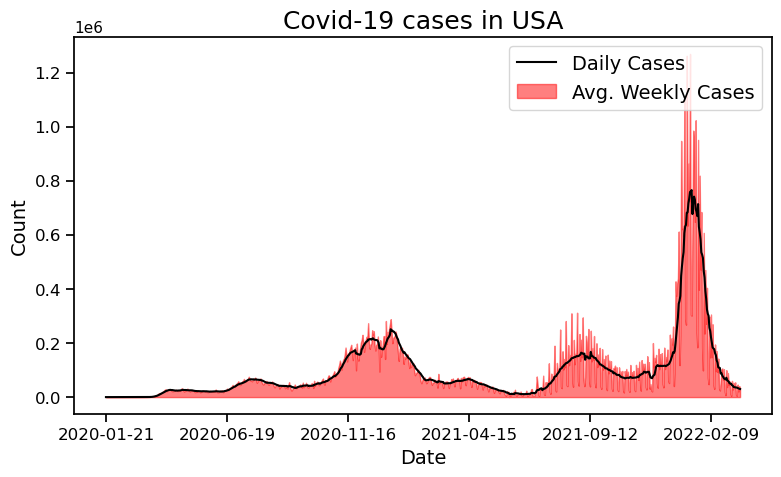

In [39]:
plot(x=df_usa['date'], y1=df_usa['daily_cases'], y2=df_usa_mav['weekly_cases'], \
     labels=['Daily Cases', 'Avg. Weekly Cases'], title='Covid-19 cases in USA')

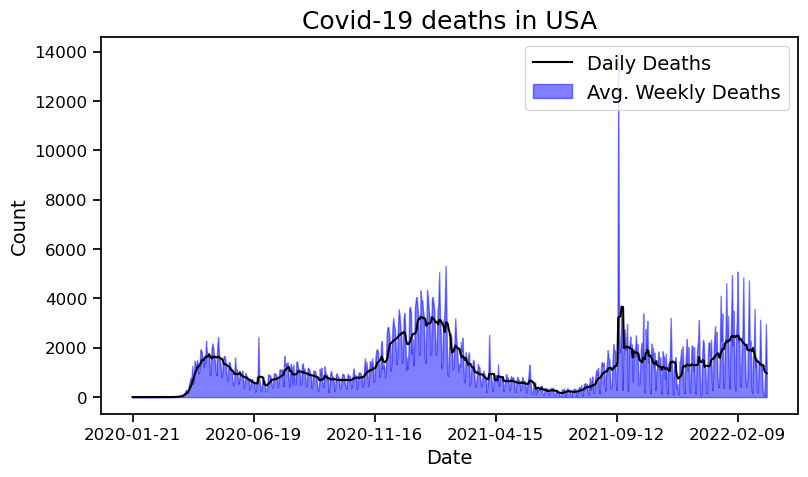

In [40]:
plot(x=df_usa['date'], y1=df_usa['daily_deaths'], y2=df_usa_mav['weekly_deaths'], \
     labels=['Daily Deaths', 'Avg. Weekly Deaths'], title='Covid-19 deaths in USA', color1='blue')

From the Covid-19 daily cases plot, we see three significant peaks centered around December 2020 (first wave peak), September 2021 (second wave peak due to Delta variant), and January 2022 (third wave peak due tro Omnicron variant). 

After the start of vaccine rollout around the month of January 2021, we see the daily observed deaths start to slowly decrease but subsequently raised during Delta wave due to vaccine resistance which warranted a booster shots which resulted in less number of deaths per cases during the Omnicron wave.

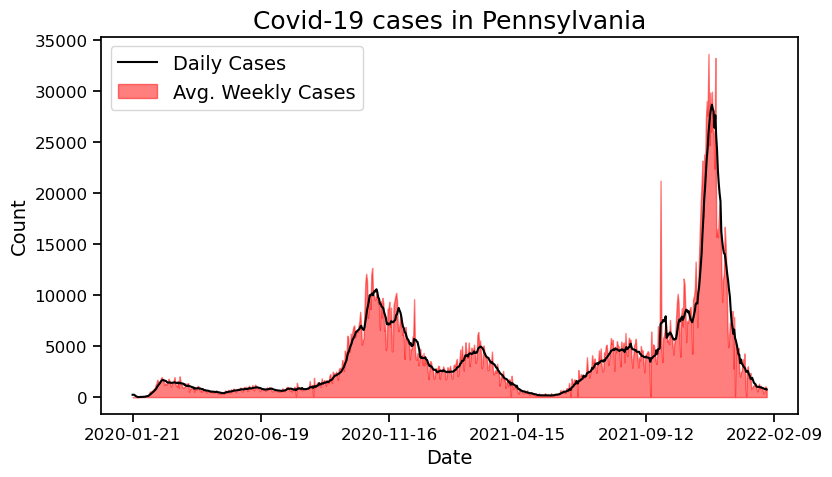

In [41]:
plot(x=df_states[df_states.state == 'Pennsylvania']['date'], y1=df_states[df_states.state == 'Pennsylvania']['daily_cases'], \
     y2=df_states_mav[df_states.state == 'Pennsylvania']['weekly_cases'], \
     labels=['Daily Cases', 'Avg. Weekly Cases'], title='Covid-19 cases in Pennsylvania')

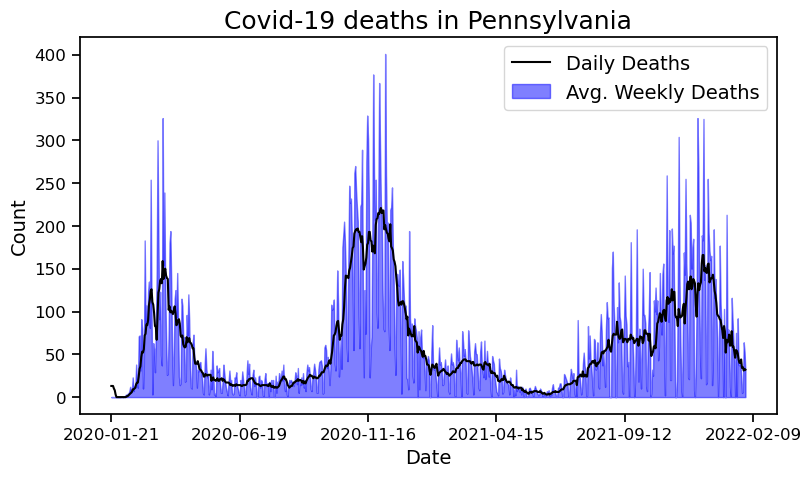

In [42]:
plot(x=df_states[df_states.state == 'Pennsylvania']['date'], y1=df_states[df_states.state == 'Pennsylvania']['daily_deaths'], \
     y2=df_states_mav[df_states.state == 'Pennsylvania']['weekly_deaths'], \
     labels=['Daily Deaths', 'Avg. Weekly Deaths'], title='Covid-19 deaths in Pennsylvania', color1='blue')

From the Covid-19 daily cases plot for the state of Pennsylvania, we see significant peaks centered around October 2020 (first wave peak) a subsequent resurgence due to slower vaccination rollouts in March 2021 and peaks in August 2021 and January 2022 due to the Delta and Omnicron variants. Note here that for the state the peaks for the Delta and Omnicron variant come fairly quickly one after the other showing that the omnicron variant peaked really fast compared to the other waves since it is more infectious.


From the Covid-19 deaths cases plot for the state of Pennsylvania, we see significant peaks centered around April 2020 (first wave peak) and the deaths peaked around November 2021, the deaths begin to slow down and then peaks in Sepetmeber 2021 and January 2022 due to the Delta and Omnicron variants. Note here that for the state the peaks for the Delta and Omnicron variant come fairly quickly one after the other showing that the omnicron variant peaked really fast compared to the other waves since it is more infectious. The rollout of vaccines and boosters clearly helped with the reduction in deaths as observed for the country wide stats.

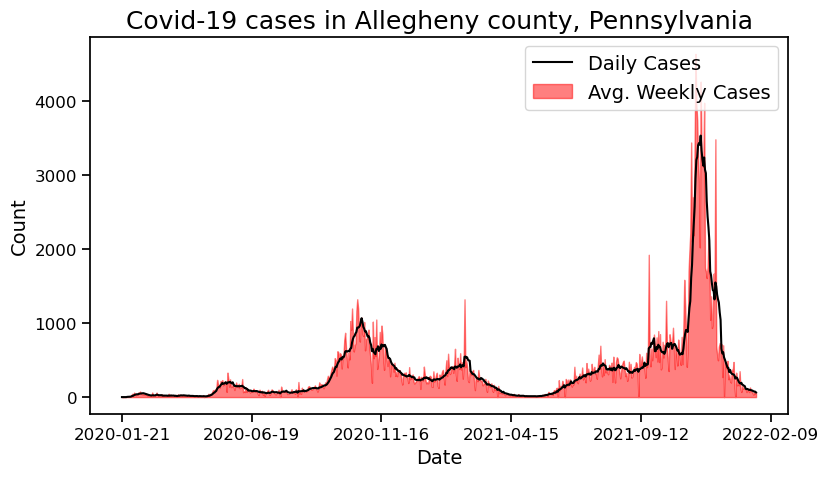

In [43]:
plot(x=df_counties[(df_counties.state == 'Pennsylvania') & (df_counties.county == 'Allegheny')]['date'], \
     y1=df_counties[(df_counties.state == 'Pennsylvania') & (df_counties.county == 'Allegheny')]['daily_cases'], \
     y2=df_counties_mav[(df_counties.state == 'Pennsylvania') & (df_counties.county == 'Allegheny')]['weekly_cases'], \
     labels=['Daily Cases', 'Avg. Weekly Cases'], title='Covid-19 cases in Allegheny county, Pennsylvania')

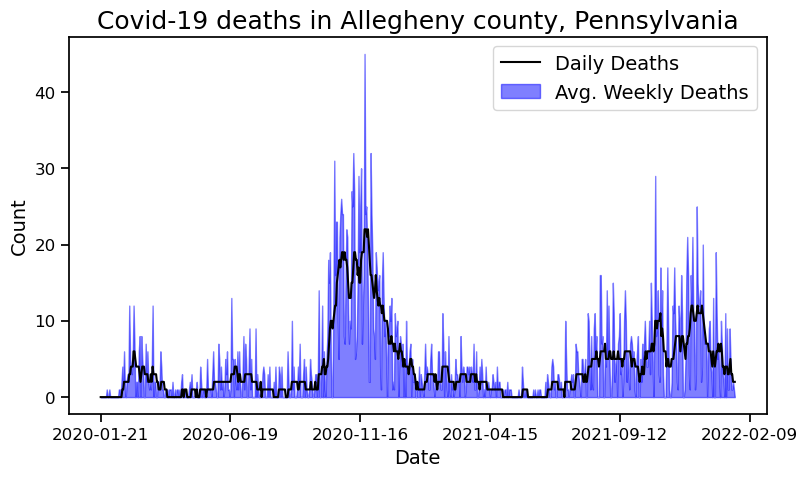

In [44]:
plot(x=df_counties[(df_counties.state == 'Pennsylvania') & (df_counties.county == 'Allegheny')]['date'], \
     y1=df_counties[(df_counties.state == 'Pennsylvania') & (df_counties.county == 'Allegheny')]['daily_deaths'], \
     y2=df_counties_mav[(df_counties.state == 'Pennsylvania') & (df_counties.county == 'Allegheny')]['weekly_deaths'], \
     labels=['Daily Deaths', 'Avg. Weekly Deaths'], title='Covid-19 deaths in Allegheny county, Pennsylvania', color1='blue')

The trends for Allegheny county, the second largest county in the state by population mirrors the trends of the state clearly. The number of cases and deaths also represent a significant percentage of the total cases and deaths in the state, this is a consequence of the high population. 

## Conclusions



- In this project we have build statistical models and performed data analysis for the COVID-19 county-wise data from the New York Times github repository.

- Addtionally we also used the county wise population to study the Covid-19 infection density to glean better interpretations. 

- Interactive Data vizualization for various states and counties were shown with the Plotly python package. 

- We found the Time series data to be stationary and computed the weekly moving average for USA, Pennsylvania and the Allegheny county. The various trends were noted and analysed. 

- A good extension of this work will be to incorporate addtional Time-series models such as ARIMA (Auto-Regressive Integrated Moving Average) to better understand the evolution of the pandemic over time and will help in forecasting subsequent waves. 